In [8]:
from plantilla import plantilla
from dotenv import dotenv_values

env = dotenv_values("../.env")

proyecto = "7. Ingreso Esperado"
subproyecto = "7.4 Analisis y resultados"

globales = plantilla(
    proyecto=proyecto,
    subproyecto=subproyecto,
    path_proyectos=r"C:\Users\Administrador\Documents\MECON",
)

path_proyecto = globales[0]  # Ubicación de la carpeta del Proyecto
path_datain = r"D:\MECON\7. Ingreso Esperado\data\data_in"  # Bases originales
path_dataout = r"D:\MECON\7. Ingreso Esperado\data\data_out"
path_scripts = globales[3]
path_figures = globales[4]  # Output para las figuras/gráficos
path_maps = globales[5]  # Output para los mapas (html o imagen)
path_tables = globales[6]  # Output para las tablas (imagen o excel)
path_programas = globales[7]

import pandas as pd
import geopandas as gpd
import numpy as np
import plotly.express as px
import seaborn as sns
pd.set_option("display.max_columns", None)

C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\scripts\7.4 Analisis y resultados
El directorio en scripts existe. Creando carpetas.
C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\data ya existe
C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\data\data_in ya existe
C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\data\data_out ya existe
C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\data\data_out\7.4 Analisis y resultados ya existe
C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\docs ya existe
C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\scripts ya existe
C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\scripts\7.4 Analisis y resultados ya existe
C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\outputs ya existe
C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\outputs\figures ya existe
C:\Users\Administrador\Documents\MECON\7. Ingreso Esperado\outputs\figures\7.4 Analisis y re

In [294]:
import pandas as pd
lmean = pd.read_stata(path_dataout + "\\7.3 Ingreso por hogar\\predict_ingreso_linkmean_resumen.dta")
lmedian = pd.read_stata(path_dataout + "\\7.3 Ingreso por hogar\\predict_ingreso_linkmedian_resumen.dta")

merged = lmean.merge(lmedian, on="link", how= "left")
merged[[col for col in merged.columns if col.startswith('bb')]] = 1- merged[[col for col in merged.columns if col.startswith('bb')]]

radios = gpd.read_file(path_datain+ "\\radios_eph\\radios_censales_clean_full.shp")
radios = radios[["link", "geometry"]]
radios["link"] = radios["link"].astype(int)
gdf = radios.merge(merged, on="link", how="left")

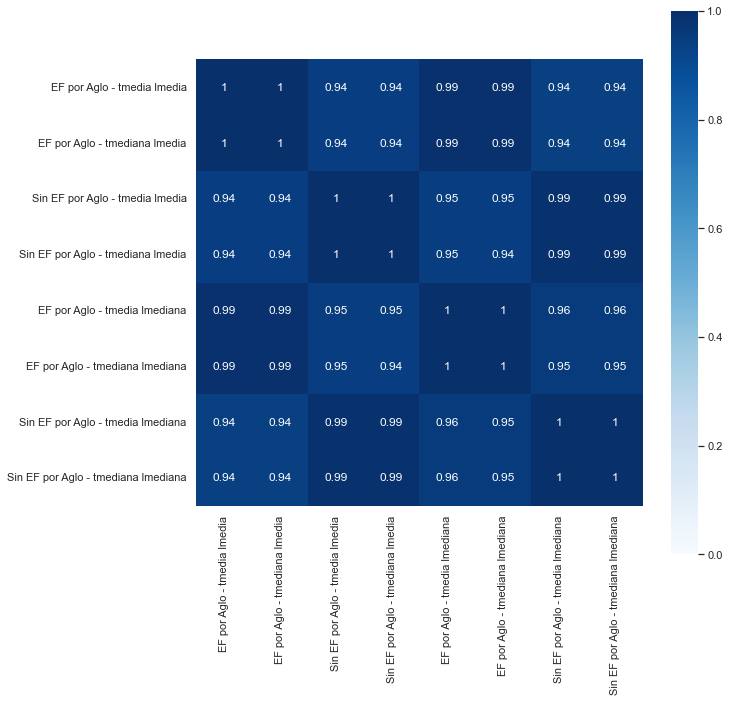

In [44]:
sns.set(rc={'figure.figsize':(10,10)})
variables = [ 'EF por Aglo - tmedia lmedia', 'EF por Aglo - tmediana lmedia',
             'Sin EF por Aglo - tmedia lmedia', 'Sin EF por Aglo - tmediana lmedia',
             'EF por Aglo - tmedia lmediana', 'EF por Aglo - tmediana lmediana',
             'Sin EF por Aglo - tmedia lmediana', 'Sin EF por Aglo - tmediana lmediana']

data = merged[[col for col in merged.columns if col.startswith('aa') or  col.startswith('dd')]]
heat = data.corr()
fig = sns.heatmap(heat, cmap="Blues",vmin=0, vmax=1,square= True, annot = True, xticklabels=variables, yticklabels=variables)
fig.figure.savefig(path_figures + "\\correlaciones_entre_modelos.png")

In [262]:
base10 = pd.read_stata(path_dataout + "\\7.3 Ingreso por hogar\\compara\\EPH10_modelos.dta")


C:\Users\Administrador\AppData\Roaming\Python\Python39\site-packages\pandas\io\stata.py:1514: UnicodeWarning:


One or more strings in the dta file could not be decoded using utf-8, and
so the fallback encoding of latin-1 is being used.  This can happen when a file
has been incorrectly encoded by Stata or some other software. You should verify
the string values returned are correct.



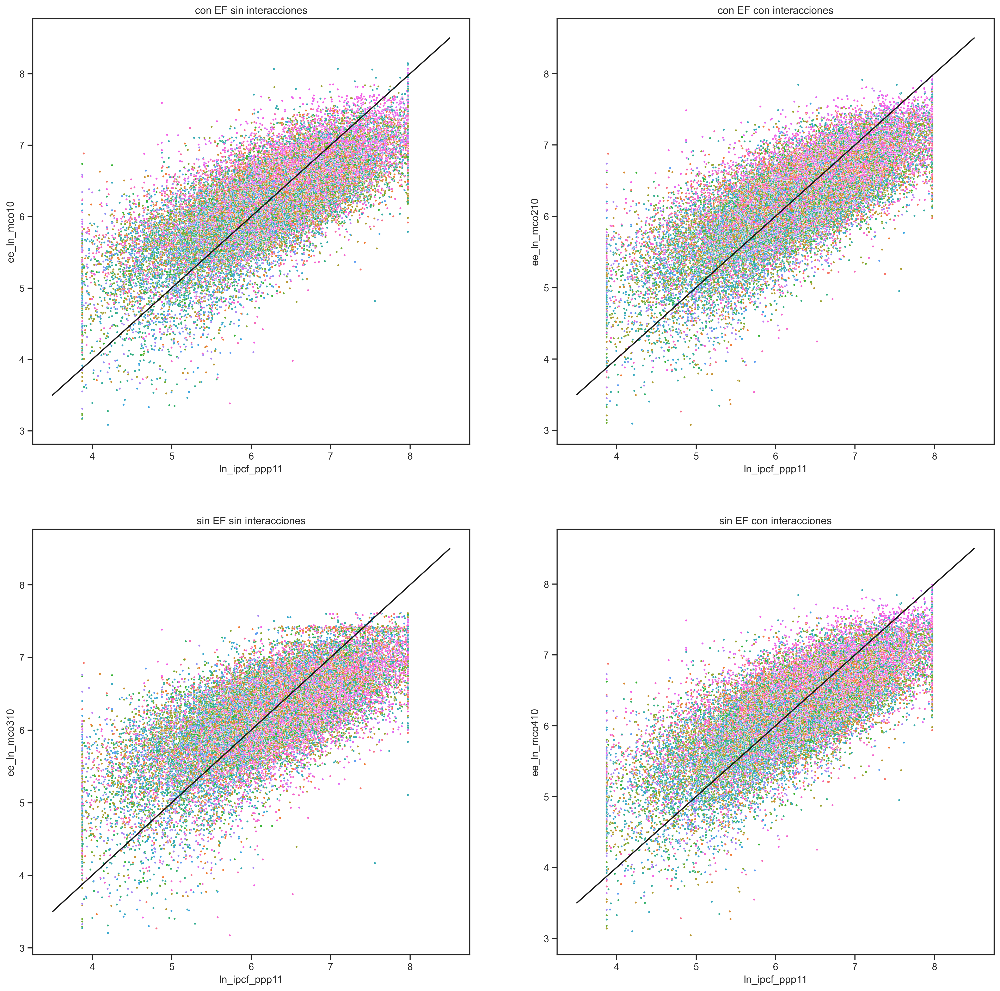

In [259]:
data = base10
varnames = [
    "con EF sin interacciones",
    "con EF con interacciones",
    "sin EF sin interacciones",
    "sin EF con interacciones",
]
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,20), dpi=300)

sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_ln_mco10",  s = 6, hue = "aglomerado", ax=axes[0][0])
sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_ln_mco210", s = 6, hue = "aglomerado", ax=axes[0][1])
sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_ln_mco310", s = 6, hue = "aglomerado", ax=axes[1][0])
sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_ln_mco410", s = 6, hue = "aglomerado", ax=axes[1][1])

for pos, ax in enumerate(axes.reshape(-1)):
    ax.title.set_text(varnames[pos])
    ax.legend([],[], frameon=False)
    ax.plot([3.5, 8.5], [3.5, 8.5], '-k') # Diag line

In [193]:
base10.aglomerado.unique().to_list()

['Gran Catamarca',
 'Gran Mendoza',
 'Gran Rosario',
 'Jujuy - Palpalá',
 'Comodoro Rivadavia - Rada Tilly',
 'Partidos del GBA',
 'Formosa',
 'La Rioja',
 'Ciudad de Buenos Aires',
 'Neuquén - Plottier',
 'Gran Tucumán - Tafí Viejo',
 'Gran La Plata',
 'Gran San Juan',
 'Concordia',
 'Gran Córdoba',
 'Corrientes',
 'San Luis - El Chorrillo',
 'Bahía Blanca - Cerri',
 'Santiago del Estero - La Banda',
 'Ushuaia - Río Grande',
 'Santa Rosa - Toay',
 'Posadas',
 'Salta',
 'Río Gallegos',
 'Gran Paraná',
 'Gran Santa Fe',
 'Río Cuarto',
 'Mar del Plata - Batán',
 'Gran Resistencia']

In [195]:
data.aglomerado

7              Partidos del GBA
10             Partidos del GBA
11             Partidos del GBA
14       Ciudad de Buenos Aires
21             Partidos del GBA
                  ...          
33218    Ciudad de Buenos Aires
33222    Ciudad de Buenos Aires
33238          Partidos del GBA
33241          Partidos del GBA
33242          Partidos del GBA
Name: aglomerado, Length: 5490, dtype: category
Categories (29, object): ['Gran La Plata' < 'Bahía Blanca - Cerri' < 'Gran Rosario' < 'Gran Santa Fe' ... 'Ciudad de Buenos Aires' < 'Partidos del GBA' < 'Mar del Plata - Batán' < 'Río Cuarto']

C:\Users\Administrador\AppData\Local\Temp\ipykernel_17528\3809339178.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



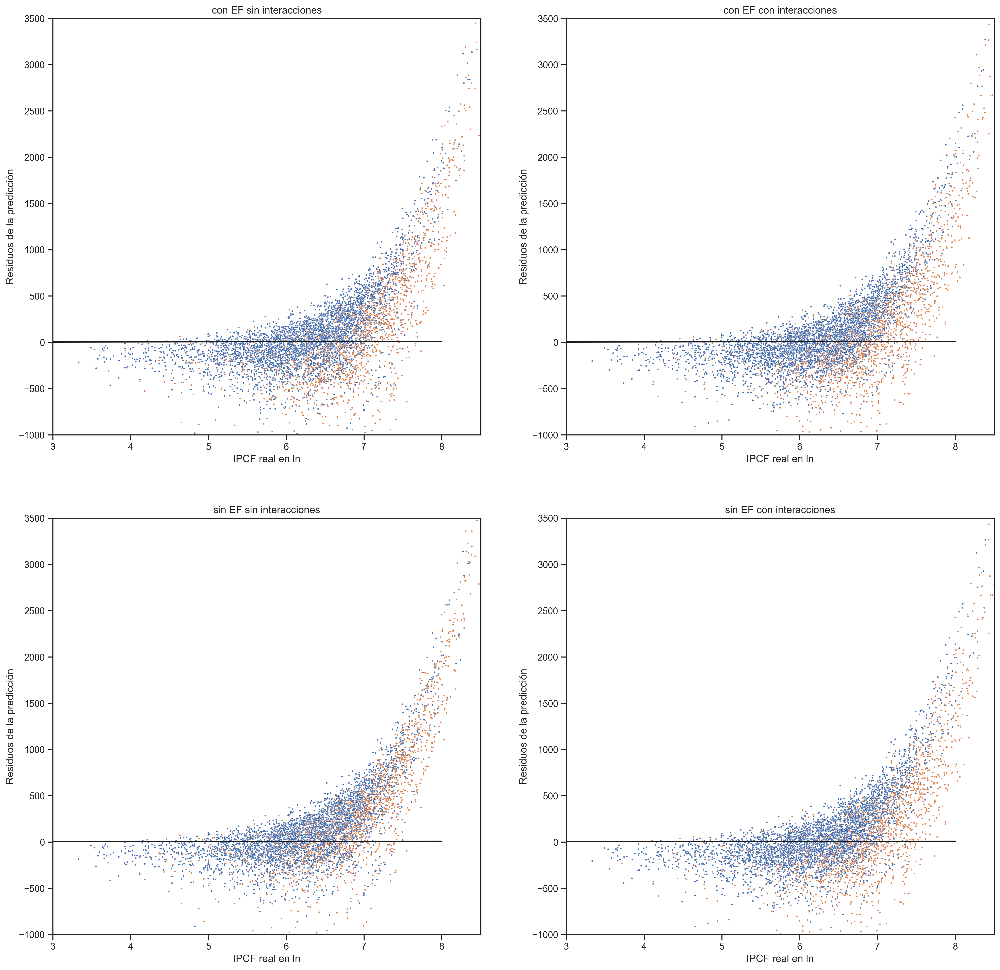

In [293]:
data = base10[base10.aglomerado.isin(["Ciudad de Buenos Aires", "Partidos del GBA"])]#, "Gran Rosario", "Gran Córdoba"])]
data.aglomerado = data.aglomerado.astype(str)
varnames = [
    "con EF sin interacciones",
    "con EF con interacciones",
    "sin EF sin interacciones",
    "sin EF con interacciones",
]
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,20), dpi=300)

sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_res_mco10",  s = 4, hue = "aglomerado", ax=axes[0][0])
sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_res_mco210", s = 4, hue = "aglomerado", ax=axes[0][1])
sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_res_mco310", s = 4, hue = "aglomerado", ax=axes[1][0])
sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_res_mco410", s = 4, hue = "aglomerado", ax=axes[1][1])

for pos, ax in enumerate(axes.reshape(-1)):
    ax.title.set_text(varnames[pos])
    ax.set_xlim(3, 8.5)
    ax.set_ylim(-1000, 3500)
    ax.legend([],[], frameon=False)
    ax.plot([0, 8.0], [0, 8], '-k') # Diag line
    ax.set_xlabel("IPCF real en ln")
    ax.set_ylabel("Residuos de la predicción")

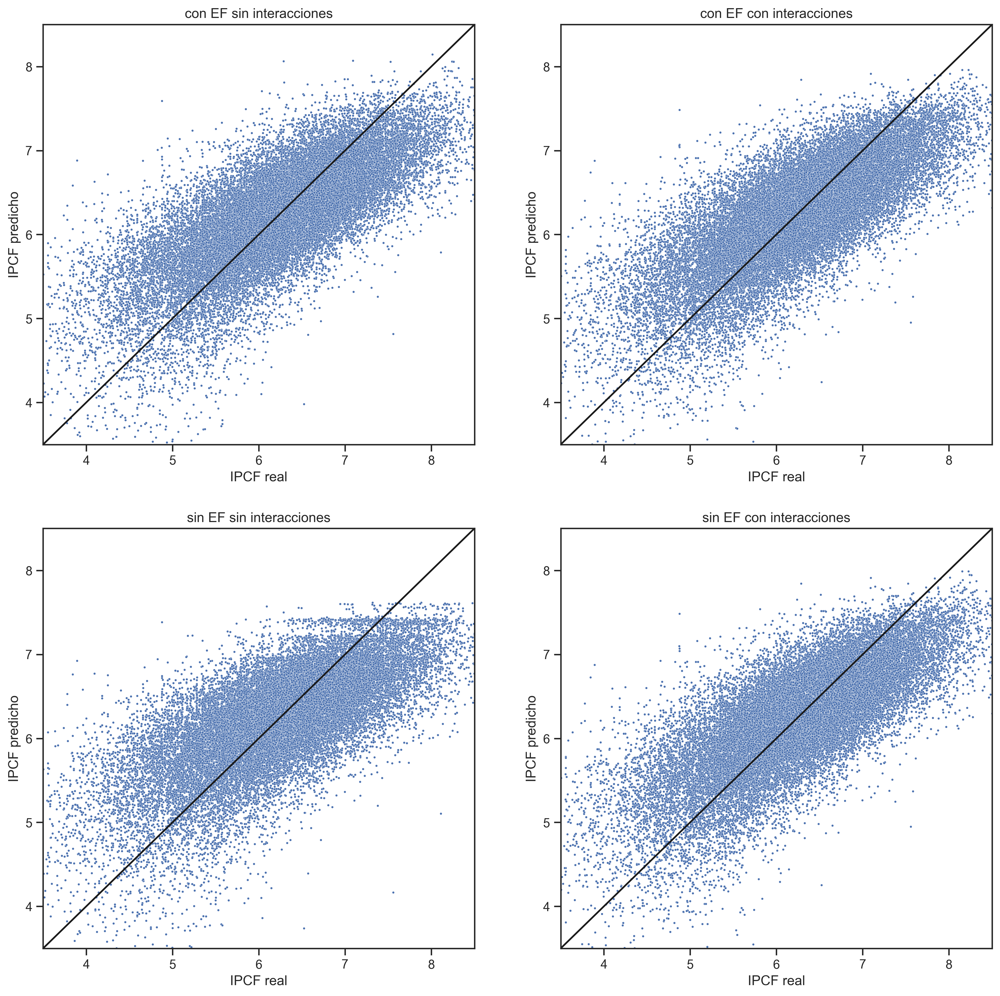

In [287]:
data = base10 #[base10.aglomerado.isin(["Ciudad de Buenos Aires", "Partidos del GBA"])]#, "Gran Rosario", "Gran Córdoba"])]
data.aglomerado = data.aglomerado.astype(str)
varnames = [
    "con EF sin interacciones",
    "con EF con interacciones",
    "sin EF sin interacciones",
    "sin EF con interacciones",
]
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15,15), dpi=300)

sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_ln_mco10",  s = 4, ax=axes[0][0])
sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_ln_mco210", s = 4, ax=axes[0][1])
sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_ln_mco310", s = 4, ax=axes[1][0])
sns.scatterplot(data=data, x="ln_ipcf_ppp11", y="ee_ln_mco410", s = 4, ax=axes[1][1])

for pos, ax in enumerate(axes.reshape(-1)):
    ax.title.set_text(varnames[pos])
    ax.set_xlim(3.5, 8.5)
    ax.set_ylim(3.5, 8.5)
    ax.legend([],[], frameon=False)
    ax.plot([0, 8.5], [0, 8.5], '-k') # Diag line
    ax.set_xlabel("IPCF real")
    ax.set_ylabel("IPCF predicho")

C:\Users\Administrador\AppData\Local\Temp\ipykernel_17528\1903539922.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



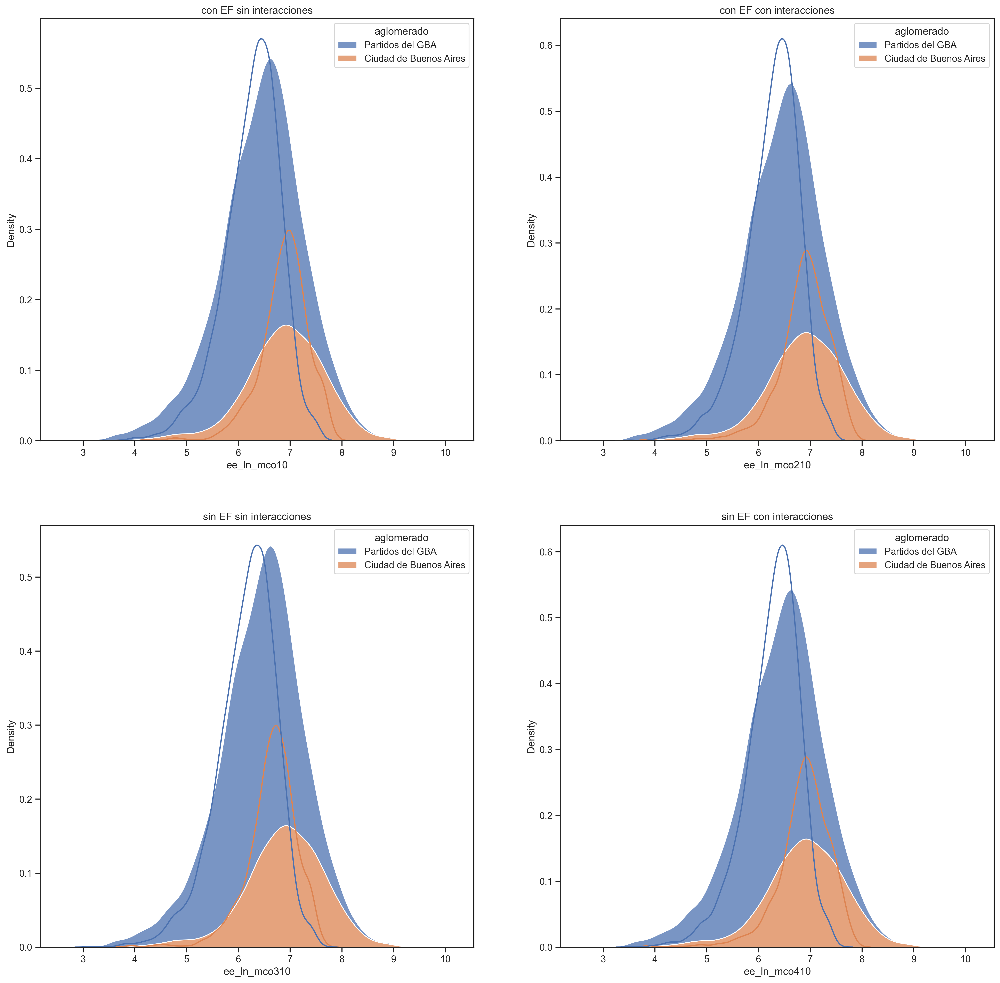

In [264]:
import matplotlib.pyplot as plt
data = base10[base10.aglomerado.isin(["Ciudad de Buenos Aires", "Partidos del GBA"])]#, "Gran Rosario", "Gran Córdoba"])]
data.aglomerado = data.aglomerado.astype(str)
varnames = [
   ["con EF sin interacciones","ee_ln_mco10"],
   ["con EF con interacciones","ee_ln_mco210"],
   ["sin EF sin interacciones","ee_ln_mco310"],
   ["sin EF con interacciones","ee_ln_mco410"]
]
varbase = "ln_ipcf_ppp11"

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,20), dpi=300)

for pos, ax in enumerate(axes.reshape(-1)):
    ax.title.set_text(varnames[pos][0])   
    ax.legend([],[], frameon=False)
    sns.kdeplot(data=data, x=varnames[pos][1],  hue = "aglomerado", ax=ax)
    sns.kdeplot(data=data, x=varbase ,multiple="stack", hue = "aglomerado", ax=ax)
    # ax.set_xlim(6.5, 8.5)
    # ax.plot([0, 8.0], [0, 8], '-k') # Diag line

C:\Users\Administrador\AppData\Local\Temp\ipykernel_17528\1186176508.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



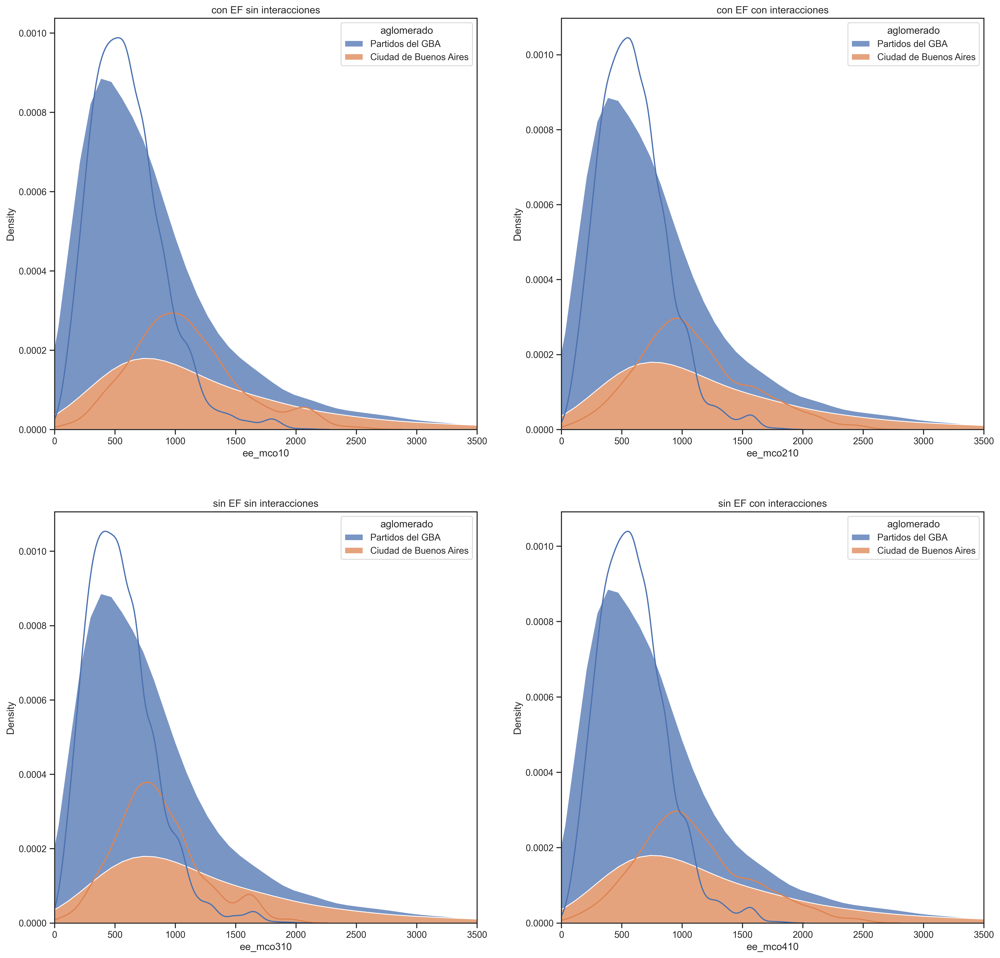

In [267]:
import matplotlib.pyplot as plt
data = base10[base10.aglomerado.isin(["Ciudad de Buenos Aires", "Partidos del GBA"])]#, "Gran Rosario", "Gran Córdoba"])]
data.aglomerado = data.aglomerado.astype(str)
varnames = [
   ["con EF sin interacciones","ee_mco10"],
   ["con EF con interacciones","ee_mco210"],
   ["sin EF sin interacciones","ee_mco310"],
   ["sin EF con interacciones","ee_mco410"]
]
varbase = "ipcf_ppp11"

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,20), dpi=300)

for pos, ax in enumerate(axes.reshape(-1)):
    ax.title.set_text(varnames[pos][0])   
    ax.legend([],[], frameon=False)
    sns.kdeplot(data=data, x=varnames[pos][1],  hue = "aglomerado", ax=ax)
    sns.kdeplot(data=data, x=varbase ,multiple="stack", hue = "aglomerado", ax=ax)
    ax.set_xlim(0, 3500)
    # ax.plot([0, 8.0], [0, 8], '-k') # Diag line

Text(0.5, 0, 'IPCF')

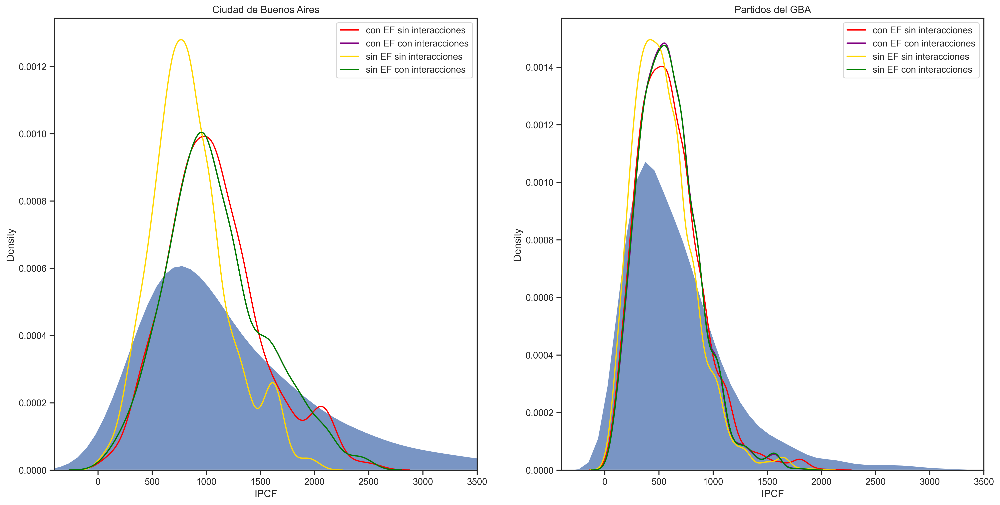

In [289]:
import matplotlib as mpl
import matplotlib.pyplot as plt
sns.set_theme(style="ticks")
# mpl.rcParams['axes.prop_cycle'] = mpl.cycler(color=[
#    "#332288", "#88CCEE", "#44AA99", "#117733", "#999933", "#DDCC77", "#CC6677", "#882255", "#AA4499"
# ]) 

data = base10 #[base10.aglomerado.isin(["Ciudad de Buenos Aires", "Partidos del GBA"])]#, "Gran Rosario", "Gran Córdoba"])]
data.aglomerado = data.aglomerado.astype(str)
varnames = [
   ["con EF sin interacciones","ee_mco10", "red"],
   ["con EF con interacciones","ee_mco210", "purple"],
   ["sin EF sin interacciones","ee_mco310", "gold"],
   ["sin EF con interacciones","ee_mco410", "green"]
]
varbase = "ipcf_ppp11"

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10), dpi=300)

sns.kdeplot(data=data[data['aglomerado']=='Ciudad de Buenos Aires'], x=varbase, multiple="stack", ax=axes[0])
for model in varnames:
   label, var, color = model
   sns.kdeplot(data=data[data['aglomerado']=='Ciudad de Buenos Aires'], x=var, label=label, ax=axes[0], color=color)
axes[0].title.set_text("Ciudad de Buenos Aires") 
axes[0].set_xlim(-400, 3500)
axes[0].legend()
axes[0].set_xlabel("IPCF")

sns.kdeplot(data=data[data['aglomerado']=='Partidos del GBA'], x=varbase, multiple="stack", ax=axes[1])
for model in varnames:
   label, var, color = model
   sns.kdeplot(data=data[data['aglomerado']=='Partidos del GBA'], x=var, label=label, ax=axes[1], color=color)

axes[1].title.set_text('Partidos del GBA') 
axes[1].set_xlim(-400, 3500)
axes[1].legend()
axes[1].set_xlabel("IPCF")


In [272]:
data.ipcf_ppp11.describe()

count    33244.000000
mean       737.333069
std        765.140625
min          7.871083
25%        302.471237
50%        543.288422
75%        920.947388
max      27146.539062
Name: ipcf_ppp11, dtype: float64

In [208]:
varnames = [
   ["con EF sin interacciones","ee_ln_mco10"],
   ["con EF con interacciones","ee_ln_mco210"],
   ["sin EF sin interacciones","ee_ln_mco310"],
   ["sin EF con interacciones","ee_ln_mco410"]
]


In [211]:
varnames[0][1]

'ee_ln_mco10'

In [50]:
reload(mapper)

<module 'mapper' from 'c:\\Users\\Administrador\\Documents\\MECON\\7. Ingreso Esperado\\scripts\\7.4 Analisis y resultados\\mapper.py'>

In [53]:
gdf

,link,geometry,pp1_lmean,pp2_lmean,pp3_lmean,pp4_lmean,pp5_lmean,pp6_lmean,pp7_lmean,pp8_lmean,pp9_lmean,pp10_lmean,pp11_lmean,pp12_lmean,pp13_lmean,pp14_lmean,pp15_lmean,pp16_lmean,pp17_lmean,pp18_lmean,pp19_lmean,pp20_lmean,pp21_lmean,pp22_lmean,pp23_lmean,pp24_lmean,pp25_lmean,pp26_lmean,pp27_lmean,pp28_lmean,pp29_lmean,pp30_lmean,aa_tmean_lmean,aa_tmedian_lmean,rr1_lmean,rr2_lmean,rr3_lmean,rr4_lmean,rr5_lmean,rr6_lmean,rr7_lmean,rr8_lmean,rr9_lmean,rr10_lmean,rr11_lmean,rr12_lmean,rr13_lmean,rr14_lmean,rr15_lmean,rr16_lmean,rr17_lmean,rr18_lmean,rr19_lmean,rr20_lmean,rr21_lmean,rr22_lmean,rr23_lmean,rr24_lmean,rr25_lmean,rr26_lmean,rr27_lmean,rr28_lmean,rr29_lmean,rr30_lmean,bb_tmean_lmean,bb_tmedian_lmean,ss1_lmean,ss2_lmean,ss3_lmean,ss4_lmean,ss5_lmean,ss6_lmean,ss7_lmean,ss8_lmean,ss9_lmean,ss10_lmean,ss11_lmean,ss12_lmean,ss13_lmean,ss14_lmean,ss15_lmean,ss16_lmean,ss17_lmean,ss18_lmean,ss19_lmean,ss20_lmean,ss21_lmean,ss22_lmean,ss23_lmean,ss24_lmean,ss25_lmean,ss26_lmean,ss27_lmean,ss28_lmean,ss29_lmean,ss30_lmean,dd_tmean_lmean,dd_tmedian_lmean,pp1_lmedian,pp2_lmedian,pp3_lmedian,pp4_lmedian,pp5_lmedian,pp6_lmedian,pp7_lmedian,pp8_lmedian,pp9_lmedian,pp10_lmedian,pp11_lmedian,pp12_lmedian,pp13_lmedian,pp14_lmedian,pp15_lmedian,pp16_lmedian,pp17_lmedian,pp18_lmedian,pp19_lmedian,pp20_lmedian,pp21_lmedian,pp22_lmedian,pp23_lmedian,pp24_lmedian,pp25_lmedian,pp26_lmedian,pp27_lmedian,pp28_lmedian,pp29_lmedian,pp30_lmedian,aa_tmean_lmedian,aa_tmedian_lmedian,rr1_lmedian,rr2_lmedian,rr3_lmedian,rr4_lmedian,rr5_lmedian,rr6_lmedian,rr7_lmedian,rr8_lmedian,rr9_lmedian,rr10_lmedian,rr11_lmedian,rr12_lmedian,rr13_lmedian,rr14_lmedian,rr15_lmedian,rr16_lmedian,rr17_lmedian,rr18_lmedian,rr19_lmedian,rr20_lmedian,rr21_lmedian,rr22_lmedian,rr23_lmedian,rr24_lmedian,rr25_lmedian,rr26_lmedian,rr27_lmedian,rr28_lmedian,rr29_lmedian,rr30_lmedian,bb_tmean_lmedian,bb_tmedian_lmedian,ss1_lmedian,ss2_lmedian,ss3_lmedian,ss4_lmedian,ss5_lmedian,ss6_lmedian,ss7_lmedian,ss8_lmedian,ss9_lmedian,ss10_lmedian,ss11_lmedian,ss12_lmedian,ss13_lmedian,ss14_lmedian,ss15_lmedian,ss16_lmedian,ss17_lmedian,ss18_lmedian,ss19_lmedian,ss20_lmedian,ss21_lmedian,ss22_lmedian,ss23_lmedian,ss24_lmedian,ss25_lmedian,ss26_lmedian,ss27_lmedian,ss28_lmedian,ss29_lmedian,ss30_lmedian,dd_tmean_lmedian,dd_tmedian_lmedian
0,20010101,"POLYGON ((-58.37425 -34.57870, -58.36795 -34.5...",292.432709,311.756317,319.407562,328.637665,358.155579,348.751831,377.952637,387.382416,391.369141,378.744415,389.017944,386.167908,420.959015,419.330505,404.425629,425.469330,450.520325,408.974945,435.039581,412.111511,421.751617,372.419342,383.391968,363.780518,358.424286,381.552216,378.588562,383.880463,345.778046,345.816040,379.399658,383.064026,0.310348,0.279521,0.223403,0.180857,0.157617,0.133262,0.110994,0.094170,0.078373,0.136596,0.098441,0.149584,0.108693,0.091468,0.133723,0.102537,0.089323,0.107387,0.090621,0.111333,0.119434,0.107606,0.115923,0.114584,0.170363,0.151099,0.157860,0.177035,0.245320,0.252395,0.853338,0.872813,216.943222,230.276031,236.748550,245.321136,265.437805,269.203796,296.720825,305.124512,309.773193,301.831909,313.525391,311.654694,326.650543,322.146484,317.815857,330.021484,349.276398,337.510376,340.428680,324.230743,343.272339,322.653870,315.242401,318.802551,296.114075,318.524628,311.419403,314.953522,285.482910,277.240601,301.811615,309.918243,156.880264,169.862259,172.043442,184.536514,208.739365,200.165359,223.083694,227.936737,222.565720,208.688309,230.109711,221.422913,243.718323,244.874374,217.787567,249.928986,269.858948,249.810196,250.272797,240.399628,248.284546,208.983963,222.174347,199.373383,186.803314,210.162064,190.043304,214.568283,180.003189,181.527817,208.213730,215.792480,0.256385,0.249432,0.180634,0.150080,0.130848,0.106022,0.081739,0.075192,0.059664,0.106258,0.071484,0.127956,0.082519,0.077414,0.120130,0.086003,0.070181,0.089612,0.069177,0.092072,0.096210,0.095447,0.104879,0.104342,0.148283,0.139238,0.138201,0.160986,0.213843,0.21849

In [61]:
dic = {
    'aa_tmedian_lmedian':'Ingesp EF no int',
    'dd_tmedian_lmedian':'Ingesp no EF no int',
}

range_color = [
    gdf.aa_tmedian_lmedian.quantile(0.05),
    gdf.aa_tmedian_lmedian.quantile(0.95)
]    

for col, nam in dic.items():

    data = gdf[[col,'geometry']]

    mapper.choropleth(
        data=data,
        variable=col,
        label=nam,
        aglo="argentina",
        out="html",
        nombre_archivo=f"Mapa_arg_{nam}",
        range_color=range_color,
    )

    mapper.choropleth(
        data=data,
        variable=col,
        label=nam,
        aglo="amba",
        out="image",
        nombre_archivo=f"Mapa_aglo_amba_{nam}",
        range_color=range_color,
    )

# choropleth(
#     data=gdf,
#     variable="n2_3_p",
#     label="cobertura",
#     out="html",
#     nombre="Mapa_pais_cobertura",
# )


In [ ]:
gb_circ = gpd.read_file(r"C:\Users\Administrador\Documents\MECON\18-Circuitos\data\data_out\18.2 Georef Electoral\resultados_circuitos.feather\resultados_circuitos.shp")


In [ ]:
gb_circ

In [ ]:
gb_circ.dm_cl1_Tru.quantile(0.85)




In [ ]:
for año in [2007, 2011, 2015, 2019]:
    for aglo in zoom_center.keys():
        choropleth(
            gb_circ[gb_circ['año']==año], 
            "dm_pp_medi", 
            aglo, 
            "var_ingreso", 
            f"var_ingreso_{año}", 
            "image", 
            "RdBu",
        )

In [ ]:
for año in [2007, 2011, 2015, 2019]:
    for aglo in zoom_center.keys():
        choropleth(
            gb_circ[gb_circ['año']==año], 
            "dm_cl1_Tru", 
            aglo, 
            "var_votos_ofi", 
            f"var_votos_ofi_{año}", 
            "image", 
            "RdBu",
        )